## Imports

In [1]:
import pandas as pd
import geopandas as gpd
from shapely.geometry import Point
import plotly.express as px
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import chi2_contingency
from fuzzywuzzy import fuzz
import plotly.graph_objects as go

## Initializing Data
#### Links to Download Datasets
<a href="https://data.montgomerycountymd.gov/Public-Safety/Crash-Reporting-Drivers-Data/mmzv-x632/about_data">Drivers Data</a>; 
<a href="https://data.montgomerycountymd.gov/Public-Safety/Crash-Reporting-Incidents-Data/bhju-22kf/about_data">Incidents Data</a>; 
<a href="https://data.montgomerycountymd.gov/Public-Safety/Crash-Reporting-Non-Motorists-Data/n7fk-dce5/about_data">Non-Motorist Data</a>;
<a href="https://opendata.maryland.gov/Administrative/Maryland-County-Boundaries/txbb-k3bc">Maryland County Boundaries Data</a>;
<a href="https://data.imap.maryland.gov/datasets/montgomery-county-maintained-roads/explore">Montgomery County Maintained Roads</a>
#### Reading in the Data

driver_dtypes = {'Local Case Number': "string"}

drivers_df = pd.read_csv("../Datasets/Crash_Reporting-Drivers_Data.csv", dtype=driver_dtypes)
incident_df = pd.read_csv("../Datasets/Crash_Reporting-Incidents_Data.csv")
non_motorist_df = pd.read_csv("../Datasets/Crash_Reporting-Non-Motorists_Data.csv")

maryland_counties = gpd.read_file("../Datasets/Maryland_County_Boundaries.geojson")
montgomery_count_geo = maryland_counties[maryland_counties["county"] == "MONTGOMERY"]["geometry"]

## Merge the Data

In [3]:
incident_df_drop_cols = incident_df[['Report Number', 'Hit/Run', 'Lane Number', 'Number of Lanes',
                                   'Road Grade', 'NonTraffic', 'First Harmful Event', 'Second Harmful Event',
                                   'Fixed Oject Struck', 'Junction', 'Intersection Type', 'Intersection Area', 
                                   'Road Alignment', 'Road Condition', 'Road Division']]
incident_df_drop_cols = incident_df_drop_cols.copy()

rename_cols = {'Hit/Run': 'Incident Hit/Run', 'Fixed Oject Struck': 'Fixed Object Struck'}
incident_df_drop_cols.rename(columns=rename_cols, inplace=True)

In [4]:
merged_df = pd.merge(drivers_df, incident_df_drop_cols, on='Report Number', how='inner')

In [5]:
non_motorist_count_df = non_motorist_df['Report Number'].value_counts().reset_index()
non_motorist_count_df.rename(columns={"index": "Report Number", "Report Number": "Num Non-Motorist Involved"}, inplace=True)

In [6]:
merged_df = pd.merge(merged_df, non_motorist_count_df, on='Report Number', how='left')

In [7]:
print(merged_df.shape)
print(drivers_df.shape)

(172004, 58)
(172004, 43)


## Check for Duplicated Data

In [8]:
merged_df.duplicated().value_counts()

False    172004
dtype: int64

## Filter Geographically

In [9]:
geometry = [Point(xy) for xy in zip(merged_df["Longitude"], merged_df['Latitude'])]
merged_gdf = gpd.GeoDataFrame(merged_df, geometry=geometry)

In [10]:
%%time
filtered_gdf = merged_gdf[merged_gdf["geometry"].within(montgomery_count_geo.unary_union)]

CPU times: total: 2min 55s
Wall time: 2min 56s


In [11]:
heatmap_df = filtered_gdf.groupby(["Latitude", "Longitude"]).size().reset_index(name="Count")

In [12]:
fig = px.density_mapbox(lat = heatmap_df.Latitude, lon = heatmap_df.Longitude, z=heatmap_df.Count,
                        radius = 9,
                        center = dict(lat = 39.128, lon = -77.202),
                        zoom = 9,
                        mapbox_style = 'open-street-map',
                        color_continuous_scale = 'rainbow',
                        opacity = 0.65)
fig.update_layout(
    width=1000,
    height=800
)
fig.show()

## Standardize Missing Data Labels

In [13]:
filtered_gdf = filtered_gdf.copy()
filtered_gdf['Vehicle Year'] = filtered_gdf['Vehicle Year'].replace(0, np.nan)
cols = ['Route Type', 'Cross-Street Type', 'Road Name', 'Cross-Street Name', 'Off-Road Description', 'Collision Type',
       'Weather', 'Surface Condition', 'Light', 'Traffic Control', 'Driver Substance Abuse', 'Driver At Fault',
       'Driver Distracted By', 'Drivers License State', 'Vehicle Damage Extent', 'Vehicle First Impact Location', 
       'Vehicle Second Impact Location', 'Vehicle Body Type', 'Vehicle Movement', 'Vehicle Continuing Dir',
       'Vehicle Going Dir', 'Driverless Vehicle', 'Vehicle Make', 'Vehicle Model', 'Equipment Problems', 'Road Grade',
       'First Harmful Event', 'Second Harmful Event', 'Fixed Object Struck', 'Junction', 'Intersection Type',
       'Road Alignment', 'Road Condition', 'Road Division', 'Non-Motorist Substance Abuse']
filtered_gdf[cols] = filtered_gdf[cols].replace(['Unknown', 'NO NAME', 'UNKNOWN', 'UNKNOWN LOCATION', 'XX', "N/A, UNKNOWN"],
                                                np.nan)

In [14]:
def plot_missing_feat(df, title):
    percent_missing = ((df.isna().sum() / df.shape[0]) * 100).reset_index()
    percent_missing.rename(columns={"index":"Feature", 0: "Percentage Missing"}, inplace=True)
    percent_missing.sort_values(by="Percentage Missing", ascending=False, inplace=True)
    plt.figure(figsize=(12,10))
    sns.barplot(x=percent_missing.columns[1], y=percent_missing.columns[0], data=percent_missing, palette='flare')
    plt.title(title)
    plt.xlabel(percent_missing.columns[1])
    plt.ylabel(percent_missing.columns[0])
    plt.show
    
def plot_missing_row(df):
    percent_missing= (df.isna().sum(axis=1) / df.shape[1])
    plt = percent_missing.hist()
    plt.set_xlabel('Percent Missing')
    plt.set_ylabel('Number of Rows')

## Check Missing Data Per Feature

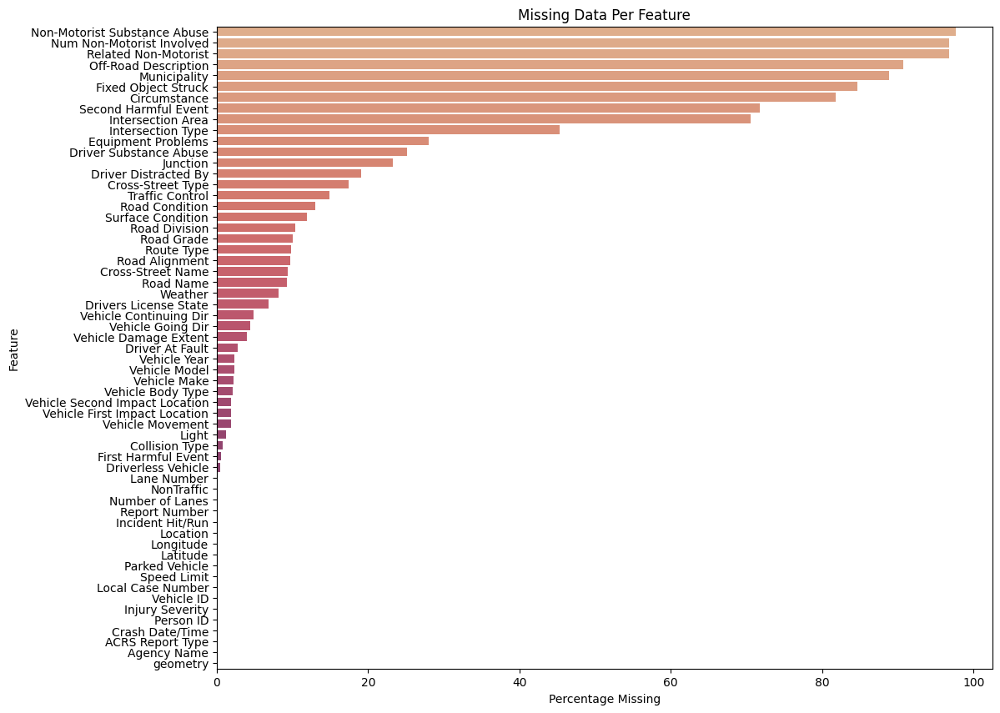

In [15]:
plot_missing_feat(filtered_gdf, "Missing Data Per Feature")

## Check Missing Data Per Observation

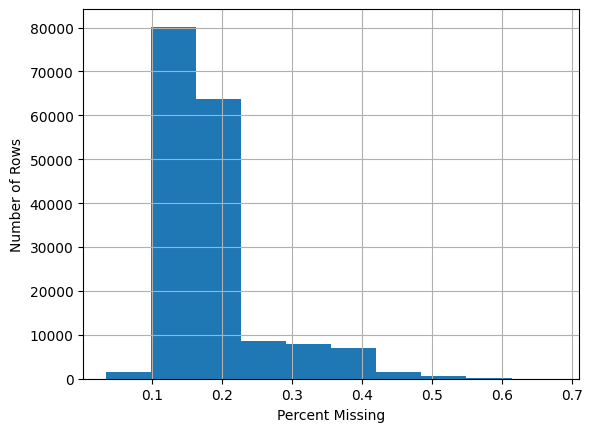

In [16]:
plot_missing_row(filtered_gdf)

## Target Variable Selection

#### Target 1: Injury Severity

In [17]:
injury_map = {"SUSPECTED SERIOUS INJURY": "SERIOUS OR FATAL INJURY", "FATAL INJURY": "SERIOUS OR FATAL INJURY",
             "SUSPECTED MINOR INJURY": "POSSIBLE OR MINOR INJURY", "POSSIBLE INJURY": "POSSIBLE OR MINOR INJURY"}
filtered_gdf["Injury Severity Remapped"] = filtered_gdf["Injury Severity"].replace(injury_map)
filtered_gdf["Injury Severity"].value_counts(normalize=True)

NO APPARENT INJURY          0.820143
POSSIBLE INJURY             0.101654
SUSPECTED MINOR INJURY      0.069102
SUSPECTED SERIOUS INJURY    0.008208
FATAL INJURY                0.000893
Name: Injury Severity, dtype: float64

In [18]:
filtered_gdf["Injury Severity Remapped"].value_counts(normalize=True)

NO APPARENT INJURY          0.820143
POSSIBLE OR MINOR INJURY    0.170756
SERIOUS OR FATAL INJURY     0.009101
Name: Injury Severity Remapped, dtype: float64

#### Target 2: Vehicle Damage Extent

In [19]:
damage_map = {"DISABLING": "DESTROYED OR DISABLING", "DESTROYED": "DESTROYED OR DISABLING",
              "NO DAMAGE": "NO DAMAGE OR SUPERFICIAL", "SUPERFICIAL": "NO DAMAGE OR SUPERFICIAL"}
filtered_gdf["Vehicle Damage Extent Remapped"] = filtered_gdf["Vehicle Damage Extent"].replace(damage_map)
filtered_gdf["Vehicle Damage Extent"].value_counts(normalize=True)

DISABLING      0.377956
FUNCTIONAL     0.272333
SUPERFICIAL    0.265246
DESTROYED      0.046098
NO DAMAGE      0.037752
OTHER          0.000614
Name: Vehicle Damage Extent, dtype: float64

In [20]:
filtered_gdf["Vehicle Damage Extent Remapped"].value_counts(normalize=True)

DESTROYED OR DISABLING      0.424054
NO DAMAGE OR SUPERFICIAL    0.302998
FUNCTIONAL                  0.272333
OTHER                       0.000614
Name: Vehicle Damage Extent Remapped, dtype: float64

#### Target 3: Number of Motorists Involved

In [21]:
num_motorist = filtered_gdf['Report Number'].value_counts().reset_index()
num_motorist.rename(columns={"index": "Report Number", "Report Number": "Num Motorist Involved"}, inplace=True)
filtered_gdf = filtered_gdf.merge(num_motorist, on='Report Number', how='left')
filtered_gdf["Num Motorist Involved"] = filtered_gdf["Num Motorist Involved"].apply(lambda x: "4+" if x >= 4 else str(x))
filtered_gdf["Num Motorist Involved"] = filtered_gdf["Num Motorist Involved"].astype(str)

In [22]:
filtered_gdf["Num Motorist Involved"].value_counts(normalize=True)

2     0.674402
1     0.180026
3     0.113760
4+    0.031812
Name: Num Motorist Involved, dtype: float64

## Exploratory Data Analysis

In [23]:
def get_cramers_v(df, target_name):
    cramers_v_df = pd.DataFrame(columns=["Feature", "Cramer's v"])
    
    for col in df.columns.tolist():
        if col != target_name:
            notna_df = df[df[col].notna()]
            contingency_table = pd.crosstab(notna_df[col], notna_df[target_name])
            chi2, _, _, _ = chi2_contingency(contingency_table)
            feature_shape = contingency_table.shape[0]
            target_shape = contingency_table.shape[1]
            n = notna_df.shape[0]
            cramers_v = np.sqrt(chi2 / (n * min(feature_shape-1, target_shape-1)))
            cramers_v_df = pd.concat([cramers_v_df, pd.DataFrame([{"Feature":col, "Cramer's v":cramers_v}])], ignore_index=True)
    cramers_v_df = cramers_v_df.sort_values(by="Cramer's v", ascending=False)
    return cramers_v_df

def plot_cramers_v(df, target_name, palette='flare'):
    plt.figure(figsize=(12,10))
    sns.barplot(x="Cramer's v", y="Feature", data=df, palette=palette)
    plt.title(f"Cramer's v {target_name}")
    plt.xlabel("Cramer's v")
    plt.ylabel("Feature")
    plt.show

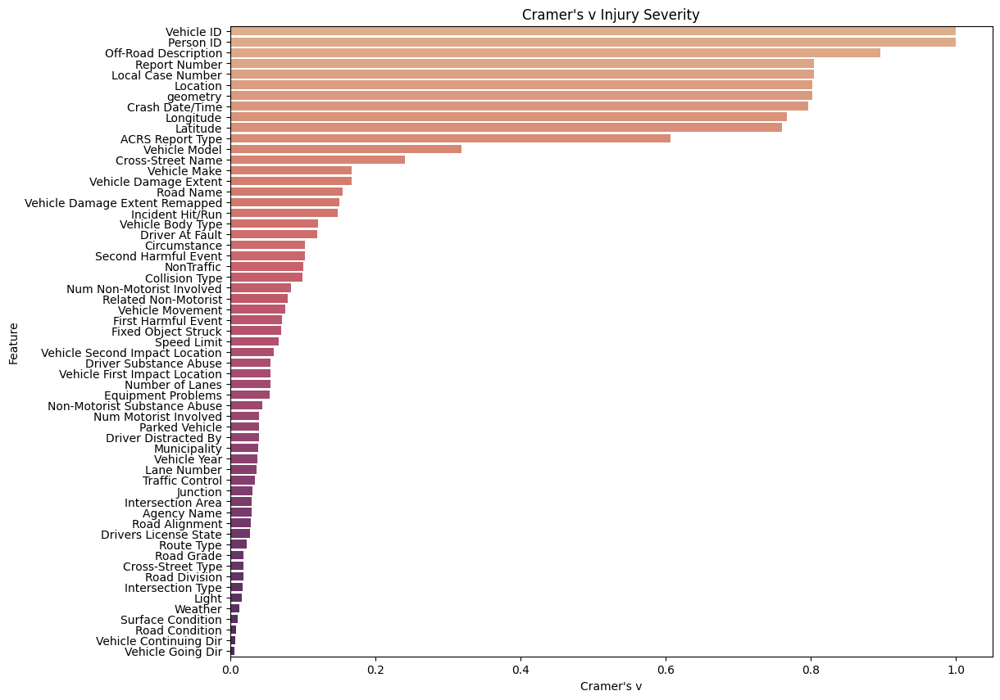

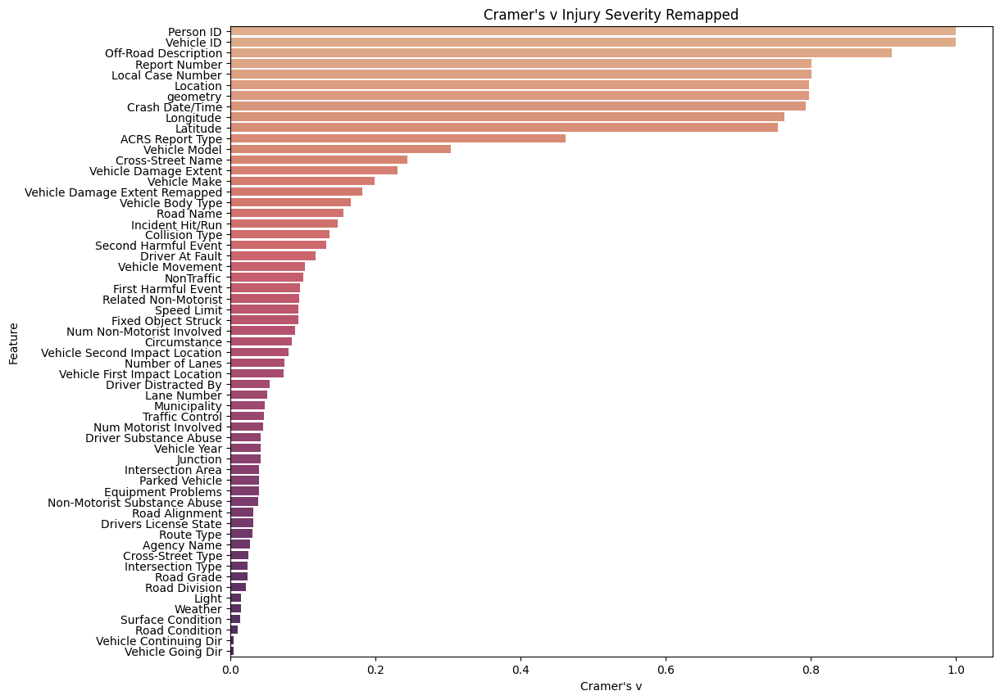

In [24]:
tar1_cv_df = get_cramers_v(filtered_gdf.drop(columns=['Driverless Vehicle', "Injury Severity Remapped"]), "Injury Severity")
tar1_cv_df2 = get_cramers_v(filtered_gdf.drop(columns=['Driverless Vehicle', 'Injury Severity']), "Injury Severity Remapped")

plot_cramers_v(tar1_cv_df, "Injury Severity")
plot_cramers_v(tar1_cv_df2, "Injury Severity Remapped")

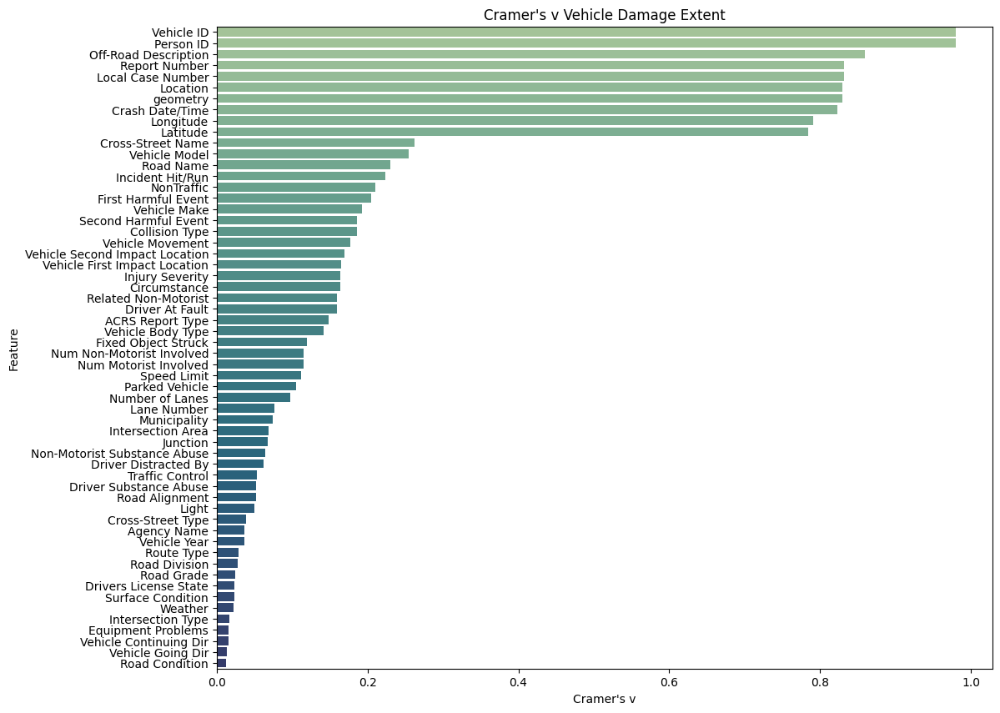

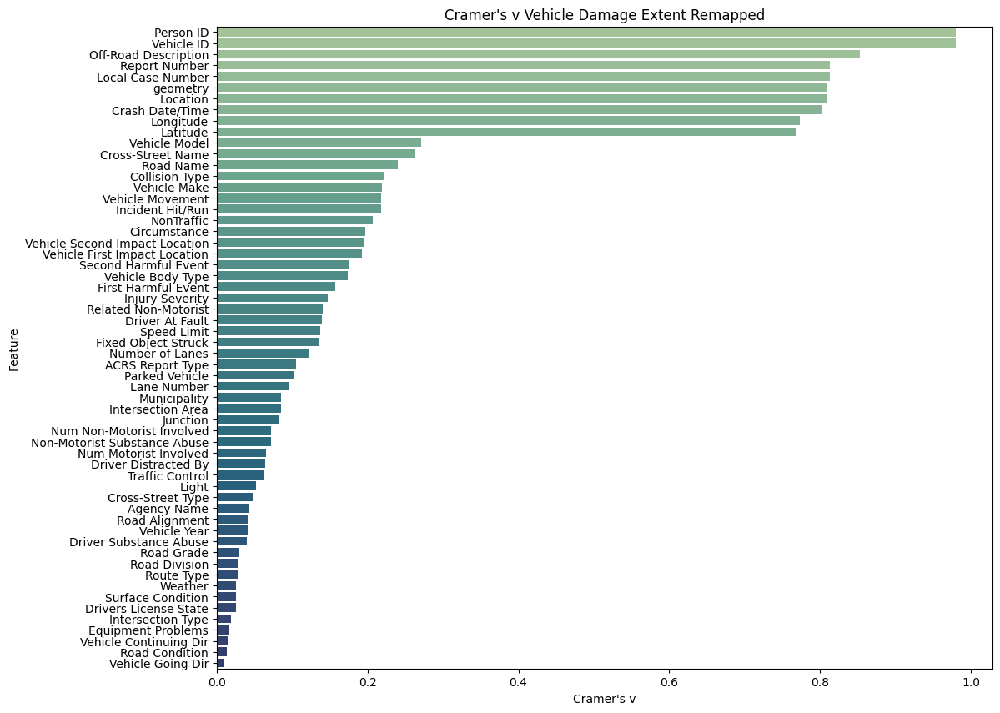

In [25]:
tar2_cv_df = get_cramers_v(filtered_gdf.drop(columns=['Driverless Vehicle', "Vehicle Damage Extent Remapped", 
                        "Injury Severity Remapped"]), "Vehicle Damage Extent")
tar2_cv_df2 = get_cramers_v(filtered_gdf.drop(columns=['Driverless Vehicle','Vehicle Damage Extent',
                        "Injury Severity Remapped"]),"Vehicle Damage Extent Remapped")

plot_cramers_v(tar2_cv_df, "Vehicle Damage Extent", palette="crest")
plot_cramers_v(tar2_cv_df2, "Vehicle Damage Extent Remapped", palette="crest")

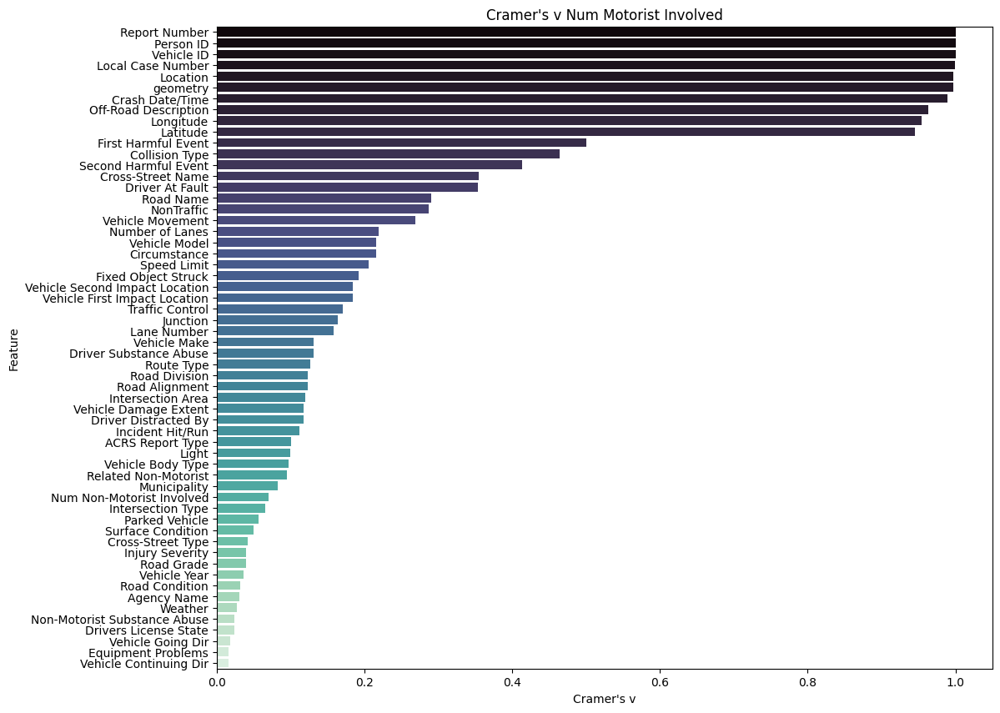

In [26]:
tar3_cv_df = get_cramers_v(filtered_gdf.drop(columns=['Driverless Vehicle', "Vehicle Damage Extent Remapped",
                        "Injury Severity Remapped"]), "Num Motorist Involved")
plot_cramers_v(tar3_cv_df, "Num Motorist Involved", palette="mako")

## Feature Selection and Engineering
#### Feature Selection & Cleaning based on Cramer's v and amount of data missing

In [27]:
target1_feats = ["Vehicle Make", "Vehicle Body Type", "Incident Hit/Run", "Collision Type", "Route Type",
                 "Driver At Fault", "Vehicle Movement", "NonTraffic", "First Harmful Event", "Speed Limit", 
                 "Vehicle Second Impact Location", "Number of Lanes", "Vehicle First Impact Location", "Lane Number"]
target2_feats = ["Collision Type", "Vehicle Make", "Vehicle Movement", "Incident Hit/Run", "NonTraffic", "Route Type",
                 "Vehicle Second Impact Location", "Vehicle First Impact Location", "Vehicle Body Type", "First Harmful Event",
                 "Driver At Fault", "Speed Limit", "Number of Lanes", "Parked Vehicle", "Lane Number", "Light"]
target3_feats = ["First Harmful Event", "Collision Type", "Driver At Fault", "NonTraffic", "Vehicle Movement",
                 "Number of Lanes", "Speed Limit", "Vehicle Second Impact Location", "Vehicle First Impact Location",
                 "Lane Number", "Vehicle Make", "Driver Substance Abuse", "Route Type", "Incident Hit/Run", "Light",
                 "Vehicle Body Type"]

In [28]:
feats_to_clean = set(target1_feats+target2_feats+target3_feats)
feats_to_clean

{'Collision Type',
 'Driver At Fault',
 'Driver Substance Abuse',
 'First Harmful Event',
 'Incident Hit/Run',
 'Lane Number',
 'Light',
 'NonTraffic',
 'Number of Lanes',
 'Parked Vehicle',
 'Route Type',
 'Speed Limit',
 'Vehicle Body Type',
 'Vehicle First Impact Location',
 'Vehicle Make',
 'Vehicle Movement',
 'Vehicle Second Impact Location'}

In [29]:
clean_gdf = filtered_gdf.copy()

#### Convert to Date/Time object

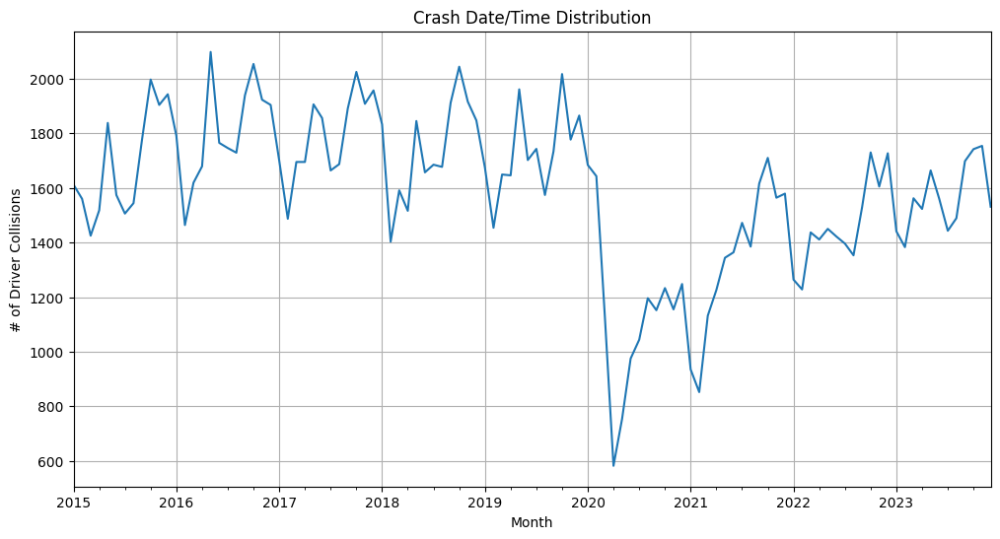

In [30]:
clean_gdf['Crash Date/Time'] = pd.to_datetime(clean_gdf['Crash Date/Time'], format="%m/%d/%Y %I:%M:%S %p")
monthly_crashes = clean_gdf.resample('M', on='Crash Date/Time').size()
plt.figure(figsize=(12, 6)) 
monthly_crashes.plot()
plt.title('Crash Date/Time Distribution')
plt.xlabel('Month')
plt.ylabel('# of Driver Collisions')
plt.grid(True)
plt.show()

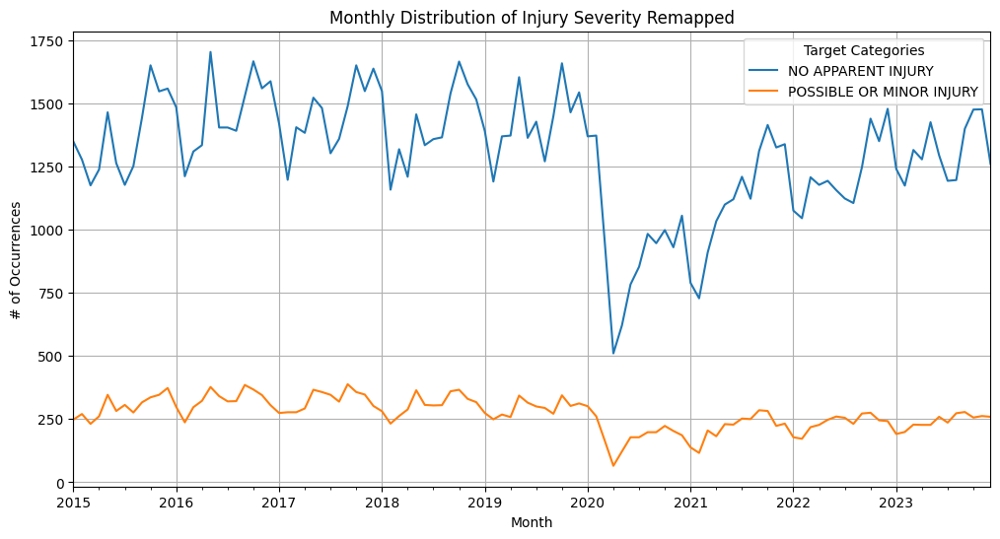

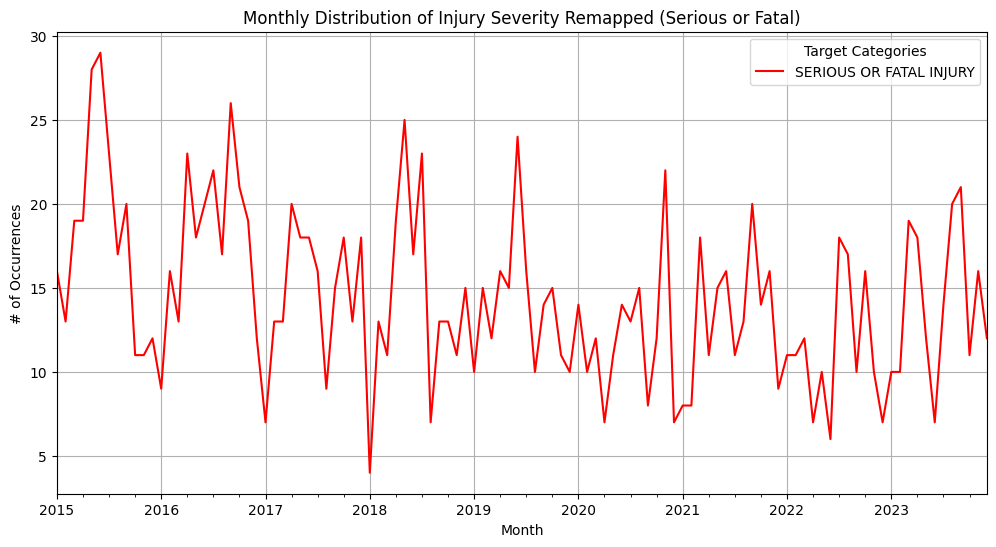

In [31]:
line_df = pd.DataFrame({
    'Date': clean_gdf['Crash Date/Time'],
    'Target': clean_gdf['Injury Severity Remapped']
})

monthly_counts = line_df.groupby([pd.Grouper(key='Date', freq='M'), 'Target']).size().unstack(fill_value=0)

plt.figure(figsize=(12, 6))
monthly_counts.drop(columns=['SERIOUS OR FATAL INJURY']).plot(kind='line', ax=plt.gca())  
plt.title('Monthly Distribution of Injury Severity Remapped')
plt.xlabel('Month')
plt.ylabel('# of Occurrences')
plt.grid(True)
plt.legend(title='Target Categories')

plt.figure(figsize=(12, 6))
monthly_counts['SERIOUS OR FATAL INJURY'].plot(kind='line', color='red', ax=plt.gca())  
plt.title('Monthly Distribution of Injury Severity Remapped (Serious or Fatal)')
plt.xlabel('Month')
plt.ylabel('# of Occurrences')
plt.grid(True)
plt.legend(['SERIOUS OR FATAL INJURY'], title='Target Categories')
plt.show()

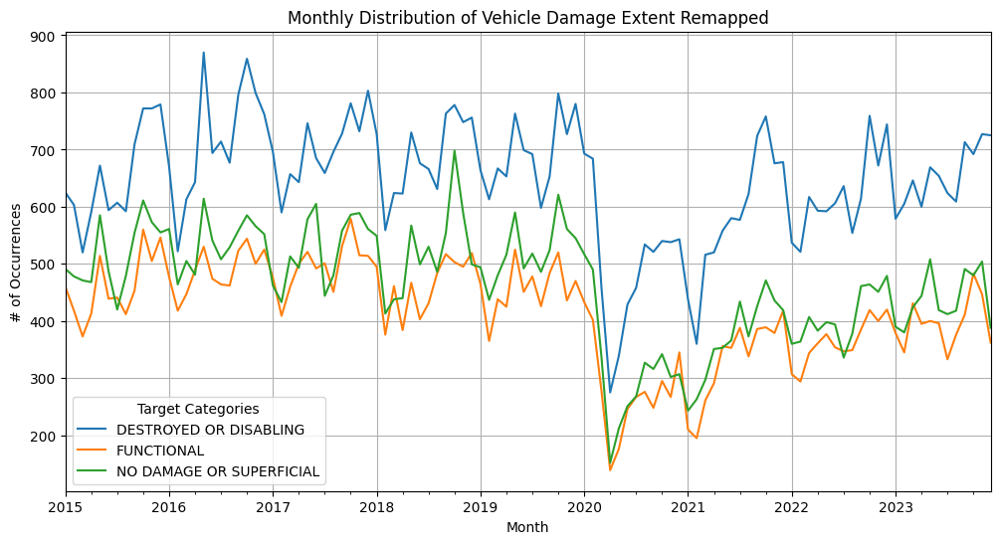

In [32]:
line_df = pd.DataFrame({
    'Date': clean_gdf['Crash Date/Time'],
    'Target': clean_gdf['Vehicle Damage Extent Remapped']
})

monthly_counts = line_df.groupby([pd.Grouper(key='Date', freq='M'), 'Target']).size().unstack(fill_value=0)

plt.figure(figsize=(12, 6))
monthly_counts.drop(columns=['OTHER']).plot(kind='line', ax=plt.gca())  
plt.title('Monthly Distribution of Vehicle Damage Extent Remapped')
plt.xlabel('Month')
plt.ylabel('# of Occurrences')
plt.grid(True)
plt.legend(title='Target Categories')
plt.show()

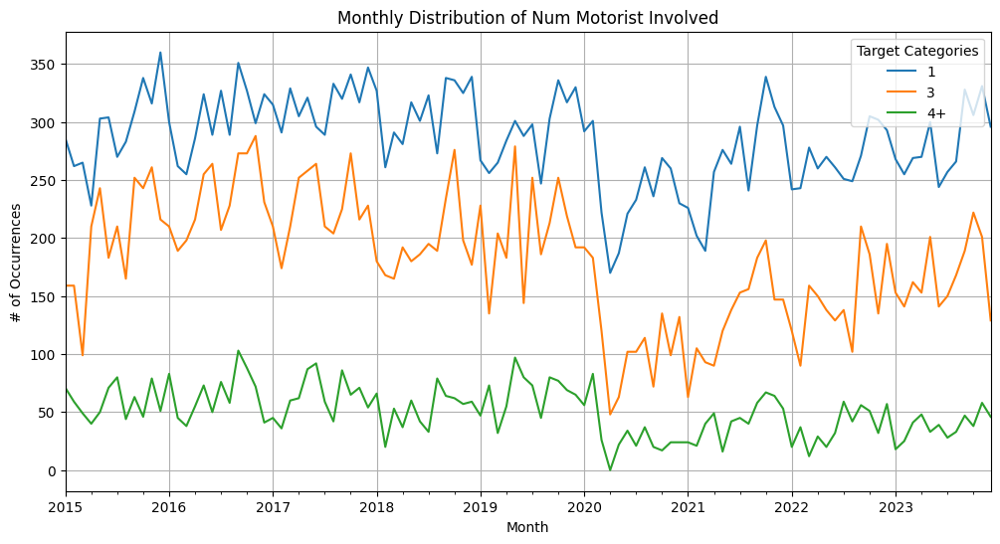

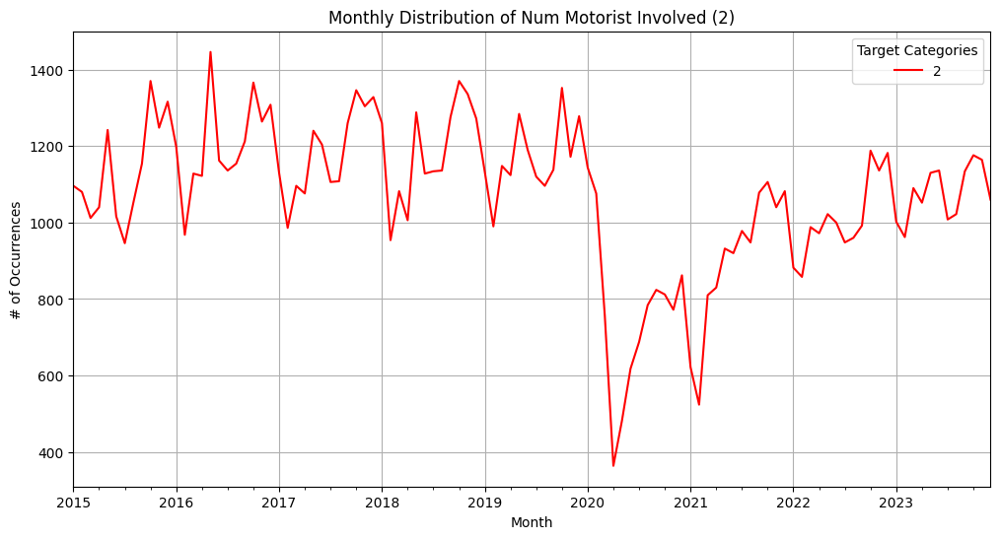

In [33]:
line_df = pd.DataFrame({
    'Date': clean_gdf['Crash Date/Time'],
    'Target': clean_gdf['Num Motorist Involved']
})

monthly_counts = line_df.groupby([pd.Grouper(key='Date', freq='M'), 'Target']).size().unstack(fill_value=0)

plt.figure(figsize=(12, 6))
monthly_counts.drop(columns=['2']).plot(kind='line', ax=plt.gca())  
plt.title('Monthly Distribution of Num Motorist Involved')
plt.xlabel('Month')
plt.ylabel('# of Occurrences')
plt.grid(True)
plt.legend(title='Target Categories')

plt.figure(figsize=(12, 6))
monthly_counts['2'].plot(kind='line', color='red', ax=plt.gca())  
plt.title('Monthly Distribution of Num Motorist Involved (2)')
plt.xlabel('Month')
plt.ylabel('# of Occurrences')
plt.grid(True)
plt.legend(['2'], title='Target Categories')
plt.show()

#### Standardize / Impute Booleans

In [34]:
bools = ['Driver At Fault', 'Incident Hit/Run', 'NonTraffic', 'Parked Vehicle']
clean_gdf[bools] = clean_gdf[bools].applymap({"Yes": True, "No":False}.get)

In [35]:
daf_distro = clean_gdf["Driver At Fault"].value_counts(normalize=True)
clean_gdf["Driver At Fault"].fillna(np.random.choice(daf_distro.index, p=daf_distro.values), inplace=True)

#### Clip numeric variables

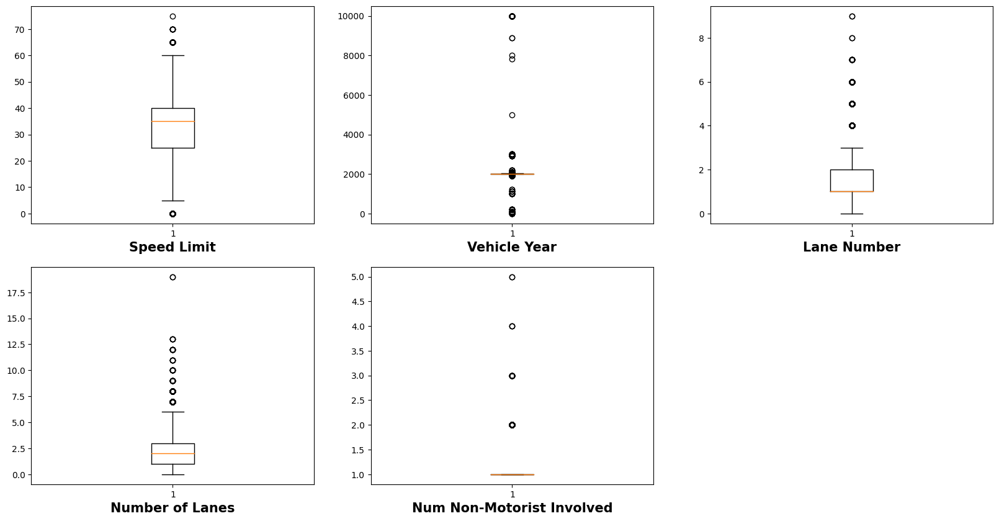

In [36]:
num_var = ['Speed Limit', 'Vehicle Year', 'Lane Number', 'Number of Lanes', 'Num Non-Motorist Involved']
plt.figure(figsize=(20,10))

for i, var in enumerate(num_var):
    plt.subplot(2,3,1+i)
    plt.boxplot(clean_gdf[var].dropna())
    plt.xlabel(var,fontsize=15, weight='bold')

In [37]:
clean_gdf[['Number of Lanes', 'Lane Number']] = clean_gdf[['Number of Lanes', 'Lane Number']].clip(upper=8)

In [38]:
def clean_vehicle_yr(row, N=40):
    month = row['Crash Date/Time'].month
    max_yr = row['Crash Date/Time'].year
    vehicle_yr = int(row['Vehicle Year'])
    if month >= 10: # new model years happen in October
        max_yr += 1
    min_yr = max_yr - 40
    
    if (vehicle_yr > max_yr or vehicle_yr < min_yr):
        vehicle_yr = np.nan
    return vehicle_yr

condition = clean_gdf['Vehicle Year'].notna()
clean_gdf.loc[condition, 'Vehicle Year'] = clean_gdf.loc[condition].apply(clean_vehicle_yr, axis=1)

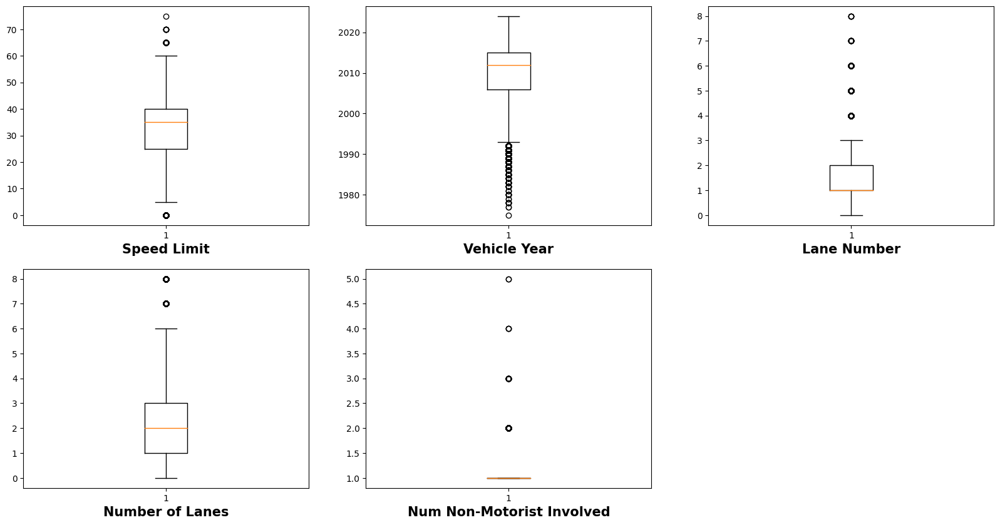

In [39]:
plt.figure(figsize=(20,10))
for i, var in enumerate(num_var):
    plt.subplot(2,3,1+i)
    plt.boxplot(clean_gdf[var].dropna())
    plt.xlabel(var,fontsize=15, weight='bold')

#### Standardize / Impute Categories

In [40]:
def mask(df, feature, old_cats, new_cat):
    df[feature] = df[feature].mask(df[feature].isin(old_cats), new_cat)

In [41]:
clean_gdf["Speed Limit"] = clean_gdf["Speed Limit"].astype(str)

In [42]:
recategorize = {"Driver Substance Abuse": {"ALCOHOL PRESENT OR CONTRIBUTED": ["ALCOHOL PRESENT", "ALCOHOL CONTRIBUTED"],
                                           "ILLEGAL DRUG PRESENT OR CONTRIBUTED": ["ILLEGAL DRUG PRESENT", "ILLEGAL DRUG CONTRIBUTED"],
                                           "MEDICATION PRESENT OR CONTRIBUTED": ["MEDICATION PRESENT", "MEDICATION CONTRIBUTED"],
                                           "COMBINED SUBSTANCE PRESENT OR CONTRIBUTED": ["COMBINED SUBSTANCE PRESENT", "COMBINATION CONTRIBUTED"],
                                           np.nan: ["OTHER"]},
               "First Harmful Event": {"NON-MOTORIST": ["PEDESTRIAN", "BICYCLE", "OTHER PEDALCYCLE", "ANIMAL"],
                                       "NON-FIXED OBJECT": ["OTHER OBJECT", "THROWN OR FALLING OBJECT", "SPILLED CARGO", "DOWNHILL RUNAWAY"],
                                       "VEHICLE MANEUVER/MALFUNCTION": ["OVERTURN", "BACKING", "U-TURN", "UNITS SEPARATED", "JACKKNIFE", "OTHER NON COLLISION"],
                                       "OTHER": ["OTHER CONVEYANCE", "FELL JUMPED FROM MOTOR VEHICLE", "RAILWAY TRAIN", "EXPLOSION OR FIRE", "IMMERSION"]},
               "Vehicle Movement": {"TURNING": ["MAKING LEFT TURN", "MAKING RIGHT TURN", "RIGHT TURN ON RED"],
                                    "PARKED/PARKING": ["PARKED", "PARKING", "STARTING FROM PARKED"],
                                    "MERGING": ["CHANGING LANES", "ENTERING TRAFFIC LANE", "LEAVING TRAFFIC LANE"],
                                    "OTHER": ["DRIVERLESS MOVING VEH."],
                                    "SKIDDING OR NEGOTIATING A CURVE": ["SKIDDING", "NEGOTIATING A CURVE"],
                                    "ACCELERATING/PASSING": ["ACCELERATING", "PASSING"]},
               "Vehicle Body Type": {"BUS": ["TRANSIT BUS", "SCHOOL BUS", "OTHER BUS", "CROSS COUNTRY BUS"],
                                        "PICKUP TRUCK": ["OTHER LIGHT TRUCKS (10,000LBS (4,536KG) OR LESS)"],
                                        "CARGO VAN": ["CARGO VAN/LIGHT TRUCK 2 AXLES (OVER 10,000LBS (4,536 KG))"],
                                        "SUV": ["(SPORT) UTILITY VEHICLE"],
                                        "MEDIUM/HEAVY TRUCKS": ["MEDIUM/HEAVY TRUCKS 3 AXLES (OVER 10,000LBS (4,536KG))", "TRUCK TRACTOR"],
                                        "PASSENGER CAR": ["STATION WAGON"],
                                        "OTHER": ["LIMOUSINE", "FARM VEHICLE", "LOW SPEED VEHICLE", "AUTOCYCLE", "ALL TERRAIN VEHICLE (ATV)", "SNOWMOBILE","RECREATIONAL VEHICLE"],
                                        "MOTORCYCLE": ["MOPED"],
                                        "POLICE VEHICLE": ["POLICE VEHICLE/EMERGENCY", "POLICE VEHICLE/NON EMERGENCY"],
                                        "AMBULANCE": ["AMBULANCE/EMERGENCY", "AMBULANCE/NON EMERGENCY"],
                                        "FIRE VEHICLE": ["FIRE VEHICLE/EMERGENCY", "FIRE VEHICLE/NON EMERGENCY"]},
               "Speed Limit": {"Below 25": ["0", "5", "10", "15", "20"],
                               "Above 55": ["60", "65", "70", "75"]}}

In [43]:
for feature, value in recategorize.items():
    for new_cat, old_cats in value.items():
        mask(clean_gdf, feature, old_cats, new_cat)

In [44]:
sub_distro = clean_gdf["Driver Substance Abuse"].value_counts(normalize=True)
clean_gdf["Driver Substance Abuse"].fillna(np.random.choice(sub_distro.index, p=sub_distro.values), inplace=True)

In [45]:
night = (clean_gdf["Crash Date/Time"].dt.hour >= 22) | (clean_gdf["Crash Date/Time"].dt.hour < 4)
day = (clean_gdf["Crash Date/Time"].dt.hour >= 9) | (clean_gdf["Crash Date/Time"].dt.hour < 16)
clean_gdf.loc[night & clean_gdf["Light"].isna(), "Light"] = "DARK -- UNKNOWN LIGHTING"
clean_gdf.loc[day & clean_gdf["Light"].isna(), "Light"] = "DAYLIGHT"

In [46]:
def fuzzy_compare(input_cat, cats, max_thr=50, min_thr=20):
    max_sim = 0
    match = None
    
    for cat in cats:
        sim = fuzz.ratio(input_cat, cat)
        if sim > max_sim:
            max_sim = sim
            match = cat
    if max_sim > max_thr:
        return match
    elif max_sim > min_thr:
        return "OTHER"
    else:
        return "UNKNOWN"

In [47]:
%%time

vehicle_makes = ["TOYOTA", "HONDA", "FORD", "NISSAN", "DODGE", "RAM", "HYUNDAI", "CHEVROLET", "JEEP", "BMW", "ACURA", "LEXUS",
        "KIA", "SUBARU", "MAZDA", "GMC", "MERCEDES", "AUDI", "CHRYSLER", "VOLVO", "VOLKSWAGON", "INFINITI", "BUICK",
        "MITSUBISHI", "MACK", "FREIGHTLINER", "LINCOLN", "SCION", "SATURN", "TESLA", "MINI", "PONTIAC", "MERCURY", "SUZUKI",
        "ISUZU", "LAND ROVER", "PORSCHE", "JAGUAR", "HARLEY DAVIDSON", "YAMAHA", "FIAT", "SAAB", "THOMAS BUILT", "KAWASAKI",
        "RANGE ROVER", "HUMMER", "MASERATI", "SMART", "TRIUMPH", "CADILLAC", "UNKNOWN"]


clean_gdf["Vehicle Make"] = clean_gdf["Vehicle Make"].apply(lambda x: fuzzy_compare(str(x), vehicle_makes, 50))

CPU times: total: 19.9 s
Wall time: 20.1 s


In [48]:
def remap_vbt_to_vmake(df, body_type_cat, possible_makes):
    mask = (df["Vehicle Body Type"] == body_type_cat) & (~df["Vehicle Make"].isin(possible_makes))
    make_distro = df[(df["Vehicle Body Type"] == body_type_cat) & (df["Vehicle Make"].isin(
                                                                possible_makes))]["Vehicle Make"].value_counts(normalize=True)
    df.loc[mask, "Vehicle Make"] = df.loc[mask, "Vehicle Make"].apply(lambda x: np.random.choice(make_distro.index,
                                                                                                p=make_distro.values))
def remap_vmake_to_vbt(df, make_cat, possible_body_types):
    mask = (df["Vehicle Make"] == make_cat) & (df["Vehicle Body Type"].isin(possible_body_types))
    bt_distro = df[(df["Vehicle Make"] == make_cat) & (~df["Vehicle Body Type"].isin(
                                                possible_body_types))]["Vehicle Body Type"].value_counts(normalize=True)
    df.loc[mask, "Vehicle Body Type"] = df.loc[mask, "Vehicle Body Type"].apply(lambda x: np.random.choice(bt_distro.index,
                                                                                                p=bt_distro.values))

In [49]:
clean_gdf.loc[clean_gdf["Vehicle Body Type"] == "PICKUP TRUCK", "Vehicle Make"] = ( 
clean_gdf.loc[clean_gdf["Vehicle Body Type"] == "PICKUP TRUCK", "Vehicle Make"].replace("DODGE", "RAM"))

vbt_to_vmake_map = {"AMBULANCE": ["OTHER", "FREIGHTLINER", "FORD"],
                    "BUS": ["OTHER", "THOMAS BUILT", "FREIGHTLINER"],
                    "CARGO VAN": ["FORD", "CHEVROLET", "OTHER", "GMC", "FREIGHTLINER", "DODGE", "RAM", "MERCEDES"],
                    "FIRE VEHICLE": ["OTHER"],
                    "MEDIUM/HEAVY TRUCKS": ["OTHER", "MACK", "FREIGHTLINER"],
                    "MOTORCYCLE": ["HONDA", "HARLEY DAVIDSON", "YAMAHA", "SUZUKI", "KAWASAKI", "OTHER", "BMW", "TRIUMPH"], 
                    "POLICE VEHICLE": ["FORD", "DODGE", "CHEVROLET", "HONDA", "BMW", "HARLEY DAVIDSON", "OTHER"],
                    "VAN": ["FORD", "HONDA", "CHEVROLET", "TOYOTA", "DODGE", "CHRYSLER", "NISSAN", "GMC", "RAM", "KIA",
                             "OTHER", "MERCEDES", "MAZDA"],
                    "PICKUP TRUCK": ["FORD", "CHEVROLET", "TOYOTA", "RAM", "GMC", "NISSAN", "OTHER", "HONDA", "JEEP"],
                    "SUV": ["TOYOTA", "HONDA", "FORD", "JEEP", "NISSAN", "CHEVROLET", "LEXUS", "ACURA", "HYUNDAI", "GMC", 
                             "SUBARU", "BMW", "KIA", "MAZDA", "HUMMER", "MERCEDES", "DODGE", "AUDI", "VOLVO", "LAND ROVER",
                             "MITSUBISHI", "CADILLAC", "INFINITI", "VOLKSWAGON", "BUICK", "LINCOLN", "PORSCHE", "SATURN",
                             "MERCURY", "ISUZU", "OTHER", "CHRYSLER", "RANGE ROVER", "SUZUKI", "TESLA", "SCION", "JAGUAR",
                             "MASERATI"]}

for key, value in vbt_to_vmake_map.items():
    remap_vbt_to_vmake(clean_gdf, key, value)
    
vmake_to_vbt_map = {"FREIGHTLINER": ["UNKNOWN", "PASSENGER CAR"],
                    "HARLEY DAVIDSON":["PASSENGER CAR"],
                    "KAWASAKI": ["PASSENGER CAR", "OTHER"],
                    "MACK": ["UNKNOWN", "PASSENGER CAR"],
                    "MINI": ["OTHER", "UNKNOWN"],
                    "SMART": ["OTHER"],
                    "THOMAS BUILT": ["OTHER", "PASSENGER CAR", "UNKNOWN"],
                    "TRIUMPH": ["OTHER"],
                    "YAMAHA": ["PASSENGER CAR", "OTHER"]}

for key, value in vmake_to_vbt_map.items():
    remap_vmake_to_vbt(clean_gdf, key, value)

    
all_known_makes = clean_gdf["Vehicle Make"].unique().tolist()
all_known_makes.remove("UNKNOWN")

for make in all_known_makes:
    remap_vmake_to_vbt(clean_gdf, make, ["UNKNOWN"])

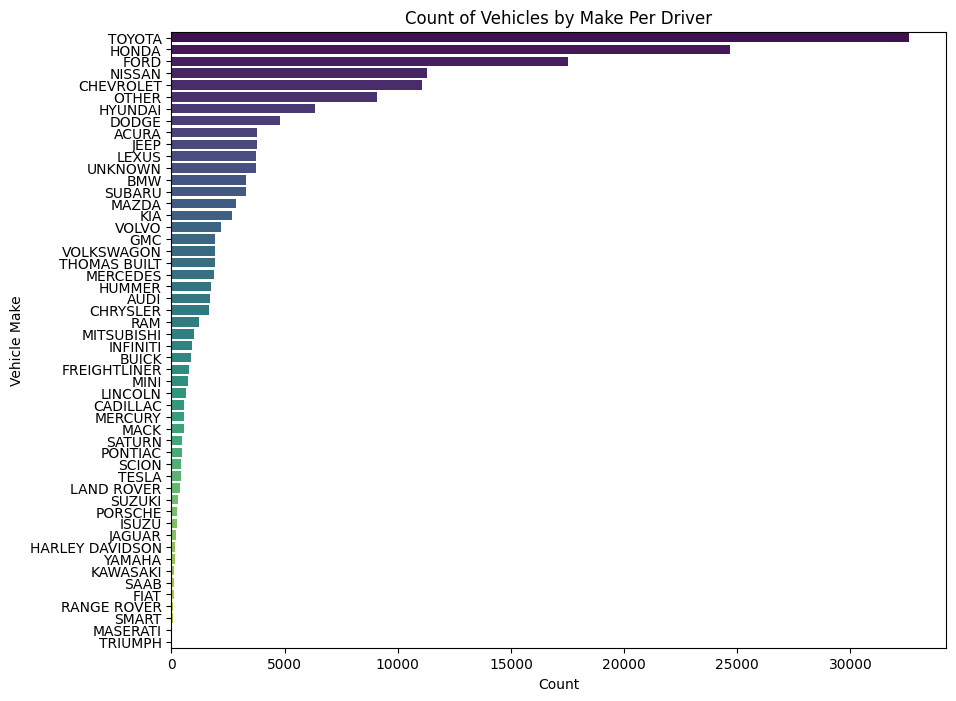

In [50]:
vehicle_make_counts = clean_gdf['Vehicle Make'].value_counts()
vehicle_make_counts_df = vehicle_make_counts.reset_index()
vehicle_make_counts_df.columns = ['Vehicle Make', 'Count']

plt.figure(figsize=(10, 8))
sns.barplot(x='Count', y='Vehicle Make', data=vehicle_make_counts_df, palette="viridis")
plt.xlabel('Count')
plt.ylabel('Vehicle Make')
plt.title('Count of Vehicles by Make Per Driver')
plt.show()

In [51]:
"""https://data.imap.maryland.gov/datasets/montgomery-county-maintained-roads/explore"""
county_roads_gdf = gpd.read_file("../Datasets/Montgomery_County_Maintained_Roads.geojson")

"""https://data.imap.maryland.gov/datasets/maryland-routes-with-zip-code-interstates-md-state-us-state/explore?location=39.026218%2C-77.098585%2C12.88"""
interstate_roads_gdf = gpd.read_file("../Datasets/Maryland_Routes_with_ZIP_Code_Interstates.geojson")

"""https://data.imap.maryland.gov/datasets/5a3ca5b40d8340a990a6351ecfde709c_0/explore?location=39.118032%2C-76.740034%2C9.77"""
municipal_road_gdf = gpd.read_file("../Datasets/Municipal_Maintained_Roads.geojson")

In [52]:
def check_interesection(poly, gdf, gdf_sindex, route_type):
    for i in gdf_sindex.intersection(poly.bounds):
        if gdf.iloc[i]["geometry"].intersects(poly):
            return route_type

In [53]:
%%time
mask = clean_gdf["Route Type"].isna()

for idx, poly in clean_gdf.loc[mask, "geometry"].items():
    route_type = check_interesection(poly.buffer(0.0003), county_roads_gdf, county_roads_gdf.sindex, "County")
    if route_type is not None:
        clean_gdf.at[idx, "Route Type"] = route_type
        continue

    route_type = check_interesection(poly.buffer(0.0007), municipal_road_gdf, municipal_road_gdf.sindex, "Municipality")
    if route_type is not None:
        clean_gdf.at[idx, "Route Type"] = route_type
        continue

    route_type = check_interesection(poly.buffer(0.001), interstate_roads_gdf, interstate_roads_gdf.sindex, "Interstate (State)")
    if route_type is not None:
        clean_gdf.at[idx, "Route Type"] = route_type

CPU times: total: 14.5 s
Wall time: 14.6 s


#### Feature Engineering

In [54]:
"""https://data-mcplanning.hub.arcgis.com/datasets/3121d8a525904c75848197c51142d761_6/explore?"""
taz_gdf = gpd.read_file("../Datasets/Traffic_Analysis_Zones.geojson")

In [55]:
%%time
clean_gdf["Traffic Analysis Zone"] = np.nan
clean_gdf["Policy Name"] = np.nan
for i in range(taz_gdf.shape[0]):
    condition = clean_gdf.geometry.within(taz_gdf.iloc[i].geometry)
    clean_gdf["Traffic Analysis Zone"] = clean_gdf["Traffic Analysis Zone"].mask(condition, taz_gdf.iloc[i]["TAZ"])
    clean_gdf["Policy Name"] = clean_gdf["Policy Name"].mask(condition, taz_gdf.iloc[i]["POLICY_NAME"])

CPU times: total: 18.4 s
Wall time: 18.5 s


In [56]:
clean_gdf["Month"] = clean_gdf["Crash Date/Time"].dt.month_name()

hour_bins = pd.cut(clean_gdf["Crash Date/Time"].dt.hour, bins=range(0, 25), right=False, labels=False)
hour_ranges = [f"{i:02d}:00:00 - {i:02d}:59:59" for i in range(24)]
clean_gdf['Hour Range'] = pd.cut(clean_gdf["Crash Date/Time"].dt.hour, bins=range(0, 25), right=False, labels=hour_ranges)

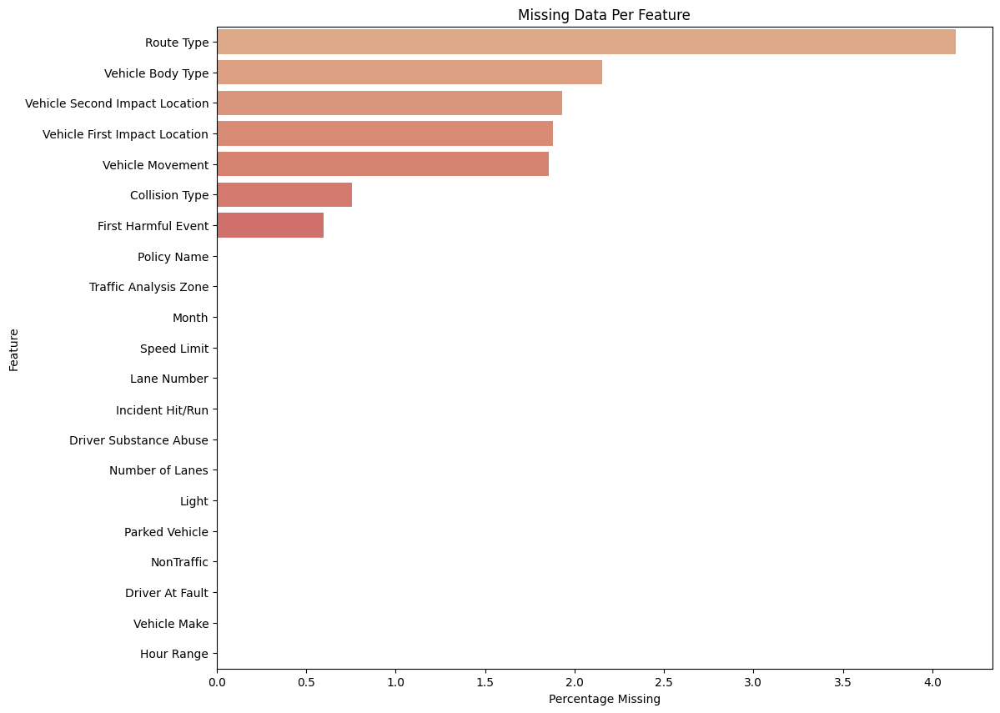

In [57]:
added_feats = ["Traffic Analysis Zone", "Policy Name", "Month", 'Hour Range']
plot_missing_feat(clean_gdf.loc[:, list(feats_to_clean)+added_feats],
                  "Missing Data Per Feature")

In [58]:
clean_gdf.to_csv("../Datasets/prepared_data.csv", index=False)

#### Final Cramer's v

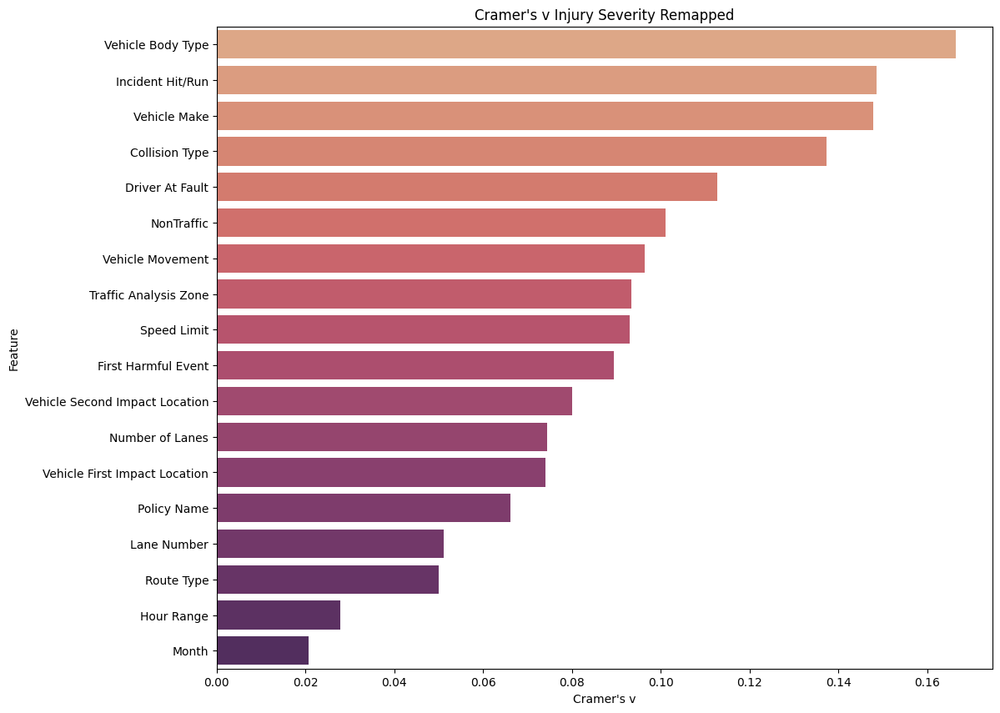

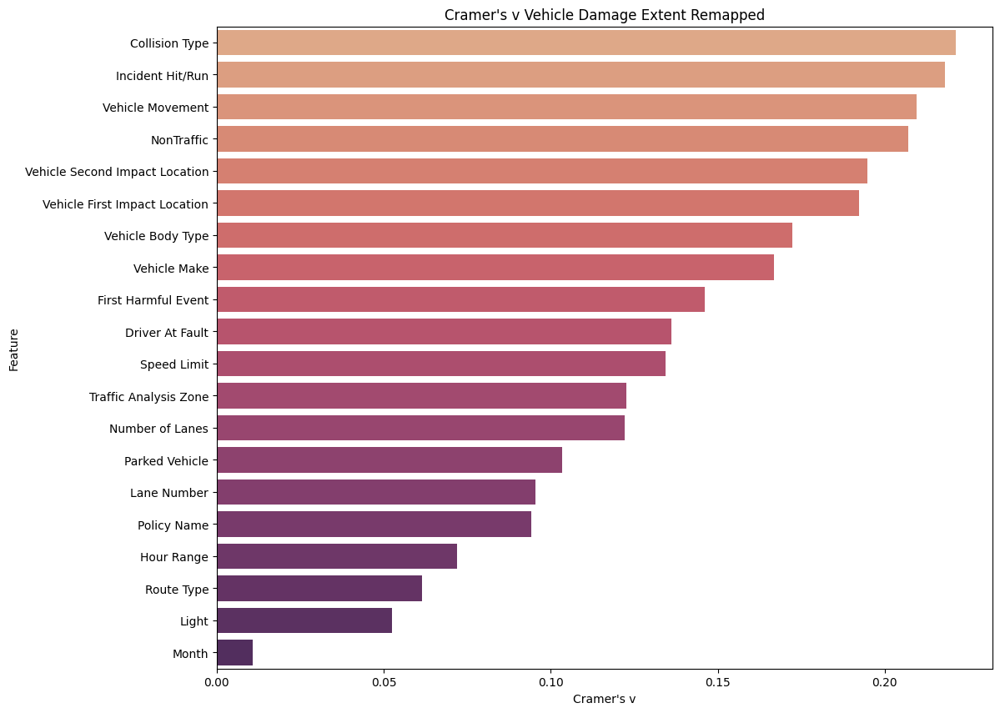

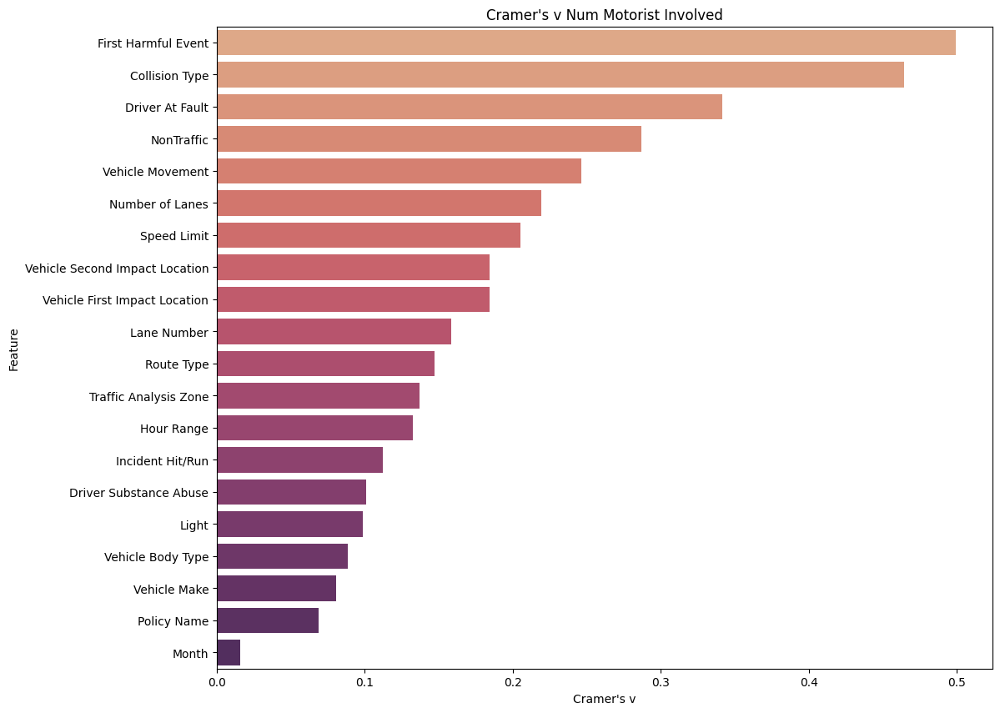

In [59]:
tar1_cv_df_final = get_cramers_v(clean_gdf[target1_feats+added_feats+["Injury Severity Remapped"]], "Injury Severity Remapped")
plot_cramers_v(tar1_cv_df_final, "Injury Severity Remapped")

tar2_cv_df_final = get_cramers_v(clean_gdf[target2_feats+added_feats+['Vehicle Damage Extent Remapped']],
                                 "Vehicle Damage Extent Remapped")
plot_cramers_v(tar2_cv_df_final, "Vehicle Damage Extent Remapped")

tar3_cv_df_final = get_cramers_v(clean_gdf[target3_feats+added_feats+['Num Motorist Involved']], "Num Motorist Involved")
plot_cramers_v(tar3_cv_df_final, "Num Motorist Involved")

## Other Visualizations

In [60]:
def plot_scatter_map(cat_colors, target, title):
    traces = []
    for category, color in cat_colors.items():
        trace = go.Scattermapbox(lat=clean_gdf[clean_gdf[target] == category]['Latitude'],
                                 lon=clean_gdf[clean_gdf[target] == category]['Longitude'], mode='markers',
                                 marker=dict(size=10, color=color, opacity=0.7), name=category)
        traces.append(trace)
        
    layout = go.Layout(title=title, mapbox=dict(style="open-street-map", zoom=9.5, center = dict(lat = 39.128, lon = -77.202)),
                       autosize=False, width=1000, height=800)

    fig = go.Figure(data=traces, layout=layout)
    fig.show()

In [61]:
injury_colors = {
    'NO APPARENT INJURY': 'green',
    'POSSIBLE OR MINOR INJURY': 'blue',
    'SERIOUS OR FATAL INJURY': 'red'
} 
plot_scatter_map(injury_colors, 'Injury Severity Remapped', 'Injury Severity Scatter Plot')

In [62]:
damage_colors = {
    'DESTROYED OR DISABLING': 'red',
    'NO DAMAGE OR SUPERFICIAL': 'green',
    'FUNCTIONAL': 'blue'
} 
plot_scatter_map(damage_colors, 'Vehicle Damage Extent Remapped', 'Vehicle Damage Geo-Scatter Plot')

In [63]:
damage_colors = {
    '1': 'green',
    '2': 'blue',
    '3': 'orange',
    '4+': 'red'
} 
plot_scatter_map(damage_colors, 'Num Motorist Involved', 'Number of Motorists Per Accident Geo-Scatter Plot')